# Downloads

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# !tar -xf /content/drive/MyDrive/ordibehesht_10K.tar.gz
!tar -xf /content/drive/MyDrive/ordibehesht.csv.tar.gz

In [ ]:
!gdown 'https://drive.google.com/u/0/uc?id=1G7eDJEfuuYzh62rZ26JlvSRaK-VvyKjm&export=download'

In [4]:
!unzip -xq '/content/roshan_internship_full_dataset_cleaned.zip'

# imports

In [5]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import os 
import glob
import PIL
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms
from torch import random
import torch.utils.data as data
import torch
import torchsummary
import torchvision.models as models
import json
from tqdm.notebook import tqdm

# Dataset Preprocess

In [6]:
df = pd.read_csv('/content/ordibehesht.csv')
df

,image,data
0,/home/sobhe/kashf/media/upload/baagheban/camer...,"[[""شاه‌پسند درختی"",true]]"
1,/home/sobhe/kashf/media/cache/5a/87/c8c2fc9c9b...,"[[""دانه غوره ای-سنسیو-رشته مروارید"",false]]"
2,/home/sobhe/kashf/media/cache/86/5d/78c864de7b...,"[[""گل انگشتانه"",false]]"
3,/home/sobhe/kashf/media/upload/baagheban/camer...,"[[""رز"",false]]"
4,/home/sobhe/kashf/media/cache/76/56/c5f9dbf3d1...,"[[""اسپاتی فیلوم"",false]]"
...,...,...
83988,/home/sobhe/kashf/media/cache/8c/6c/d727ca6341...,NaN
83989,/home/sobhe/kashf/media/cache/ba/be/87359e0b05...,NaN
83990,/home/sobhe/kashf/media/cache/a5/a6/6ac43f5fc8...,NaN
83991,/home/sobhe/kashf/media/cache/53/25/61432db5b5...,NaN


In [ ]:
def extract_string(x):
    # Check if the value is missing
    if pd.isna(x):
        return None
    # Convert non-string objects to string
    x = str(x)
    my_list = json.loads(x)
    # Check if the second item in the inner list is True
    result = my_list[0][0].encode('utf-8', "ignore").decode('utf-8')
    return result

def extract_true_flase(x):
    # Check if the value is missing
    if pd.isna(x):
        return None
    # Convert non-string objects to string
    x = str(x)
    my_list = json.loads(x)
    # Check if the second item in the inner list is True
    result = my_list[0][1]
    return result

def extract_image_name(x):
  x = str(x)
  name = x.split('/')[-1]
  return name

df['new_labels'] = df['data'].apply(extract_string)
df['true_flase'] = df['data'].apply(extract_true_flase)
df['image']      = df['image'].str.replace(r'\.\w+$', '.jpg', regex=True)


df = df.dropna(subset=['new_labels', 'true_flase'])
# df = df[~df['true_flase'].isin([False])]

final_df = df.copy()
final_df

In [ ]:
final_df.reset_index(drop=True, inplace=True)
final_df['image_name'] = final_df['image'].apply(extract_image_name)
final_df = final_df.drop_duplicates(subset='image_name', keep=False)

## Deleting unrelated images

In [ ]:
!pip install mtcnn

In [ ]:
import os
import cv2
import dlib
from tqdm.notebook import tqdm

image_folder = "/content/roshan_internship_full_dataset_cleaned"
detector = dlib.get_frontal_face_detector()
bad_images = []
for filename in tqdm(os.listdir(image_folder)):
    if filename.endswith('.jpg') or filename.endswith('.png'): # filter images by extension
        image_path = os.path.join(image_folder, filename)
        image = cv2.imread(image_path)
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        faces = detector(gray)
        if faces:
            bad_images.append(filename)
            # print(1)

  0%|          | 0/65574 [00:00<?, ?it/s]

In [9]:
# Open the "bad_images.txt" file for reading
with open('/content/drive/MyDrive/bad_images.txt', 'r') as f:
    # Read the contents of the file into a list, stripping off any newline characters
    bad_images = [line.strip() for line in f.readlines()]

In [10]:
print(len(bad_images))
print()
print((bad_images[:5]))

535

['e52726a40c6d116f2ad657eadd30db35ba75be7b4a280b2cee85.jpg', '1620.jpg', '55606971adfdfbef47b8515a8843a1b1a79045d97d8dc0eca916.jpg', 'd0904dead91b91180a15d5a0b350193b5483935228c818bd6068.jpg', '792856400551-goldoon_2019_02_13_11_59_41.jpg']


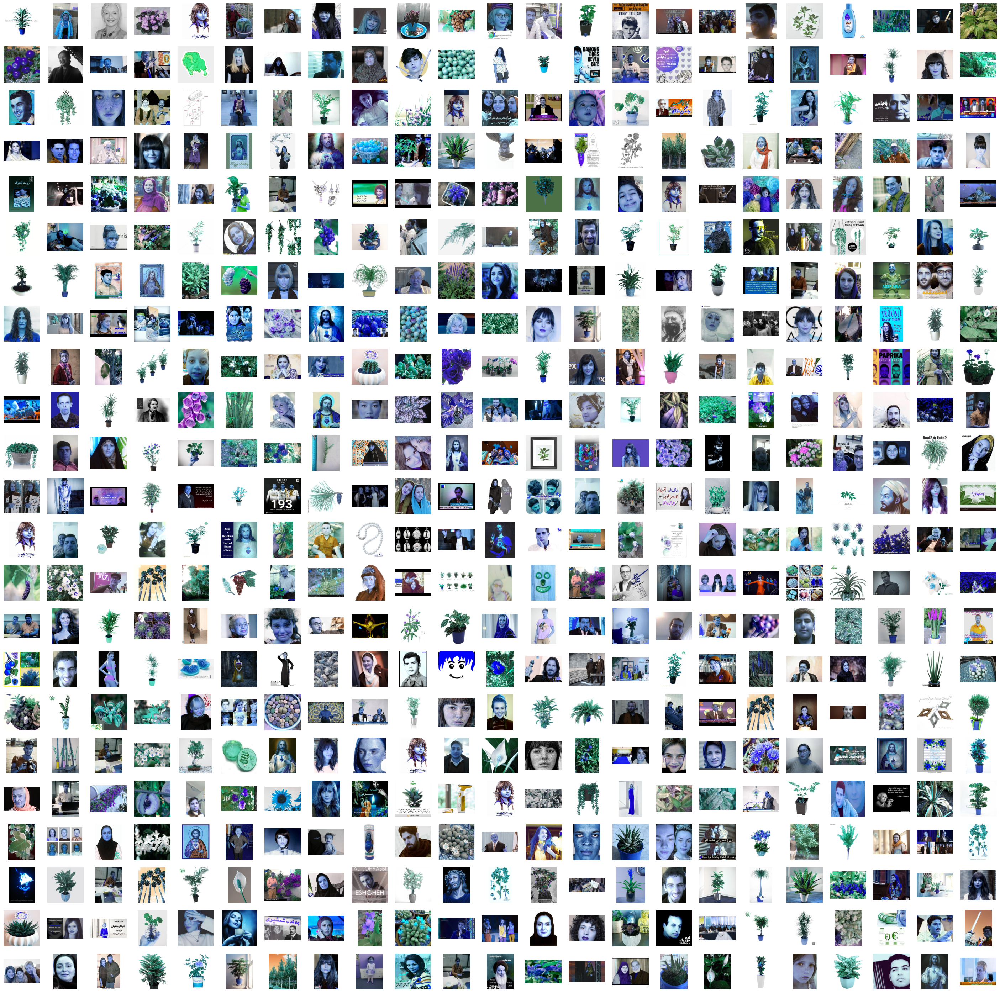

In [ ]:
fig, ax = plt.subplots(ncols = 23 , nrows = 23 ,figsize=(36 ,36))
for i in range(23*23):
  img = cv2.imread(os.path.join( '/content/roshan_internship_full_dataset_cleaned' , bad_images[i]))
  ax[i//23][i%23].imshow(img)
  ax[i//23][i%23].axis('off')

In [ ]:
with open('bad_images.txt', 'w') as f:
    # Loop over each element in the list
    for element in bad_images:
        # Check if the element is a string
        if isinstance(element, str):
            # Write the string to the file, followed by a newline character
            f.write(element + '\n')

In [ ]:
for image in tqdm(bad_images):
  os.remove(os.path.join( '/content/roshan_internship_full_dataset_cleaned' , image))

## Cleaning DataFrame

In [12]:
image_names = list(final_df['image_name'])
available_images = os.listdir('/content/roshan_internship_full_dataset_cleaned')

In [ ]:
# Drop the row if its name is not in the available names
final_df = final_df[final_df['image_name'].isin(available_images)]
final_df.reset_index(drop=True, inplace=True)

In [14]:
# Delete rows with less than 20 image
final_df = final_df.groupby('new_labels').filter(lambda x: True if len(x) >= 200 else False)
final_df.reset_index(drop=True, inplace=True)

In [ ]:
final_df = final_df[~((final_df['true_flase'] == True) & (final_df['image_name'].isin(bad_images)))]

In [ ]:
final_df

In [ ]:
pd.get_dummies(final_df['new_labels'])

# Initail Config

In [17]:
NUM_CLASSES = 130
BATCH_SIZE = 32
IMAGE_SIZE = 150
NUM_EPOCHS = 10
SEED = 101

torch.manual_seed(SEED) 
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Dataloader

In [18]:
class CustomDataset(data.Dataset):
  def __init__(self, root ,data_frame, transform):
    self.root = root
    self.data_frame = data_frame.reset_index(drop=True)
    self.input_transform = transform

    print(f'{len(self.data_frame)} Images found')

  def __getitem__(self,idx):
    image_path = os.path.join(self.root, self.data_frame['image_name'][idx])
    pil_img = Image.open(image_path)
    img = self.input_transform(pil_img)
    label = np.argmax(np.array(pd.get_dummies(self.data_frame['new_labels']).loc[idx]))
    
    true_flase = self.data_frame['true_flase'][idx]
    return img, label, true_flase

  def __len__(self):
    return len(self.data_frame)

In [19]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(final_df, test_size=0.3)

In [20]:
transform_train = transforms.Compose([
          transforms.RandomApply(
            torch.nn.ModuleList([
              transforms.RandomRotation(degrees= 10),
              transforms.RandomHorizontalFlip(),
              transforms.RandomVerticalFlip(),
          ])),
          transforms.Resize((IMAGE_SIZE,IMAGE_SIZE)),
          transforms.ToTensor(),
          transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
          transforms.Lambda(lambda x: torch.clamp(x, 0, 1)), 
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
    transforms.Lambda(lambda x: torch.clamp(x, 0, 1)), 
])

In [21]:
dataset_train = CustomDataset(root = '/content/roshan_internship_full_dataset_cleaned' , data_frame= train, transform=transform_train)
dataset_test  = CustomDataset(root = '/content/roshan_internship_full_dataset_cleaned' , data_frame= test , transform=transform_test)

33782 Images found
14479 Images found


In [22]:
from torch.utils.data import Dataset, DataLoader
data_loader_train = DataLoader(dataset_train, batch_size=BATCH_SIZE, drop_last = True, shuffle=True, num_workers=2)
data_loader_test  = DataLoader(dataset_test,  batch_size=BATCH_SIZE, drop_last = True, shuffle=True, num_workers=2)

In [ ]:
X, Y, TF = next(iter(data_loader_train))
X, Y, TF = X.to(device), Y.to(device), TF.to(device)
print('X shape:', X.shape, X.dtype)
print('Y shape:', Y.shape, Y.dtype)
print()
Y

X shape: torch.Size([32, 3, 150, 150]) torch.float32
Y shape: torch.Size([32]) torch.int64



tensor([ 61,  69,  40, 108,  77,  27, 100,  46,  40, 109,  42,  33,  26,  48,
          4,  31,  17, 101,   5,  97,  19,   7,  73,   7,  65,  42, 123,  96,
        126, 104,   4,  39], device='cuda:0')

In [ ]:
TF

tensor([ True, False, False, False,  True, False,  True,  True,  True, False,
         True,  True, False,  True,  True, False,  True, False, False, False,
         True,  True,  True,  True,  True,  True, False, False, False,  True,
        False,  True,  True,  True, False,  True,  True, False,  True,  True,
        False,  True,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True,  True,  True,  True,  True,  True, False,  True,
        False,  True,  True,  True], device='cuda:0')

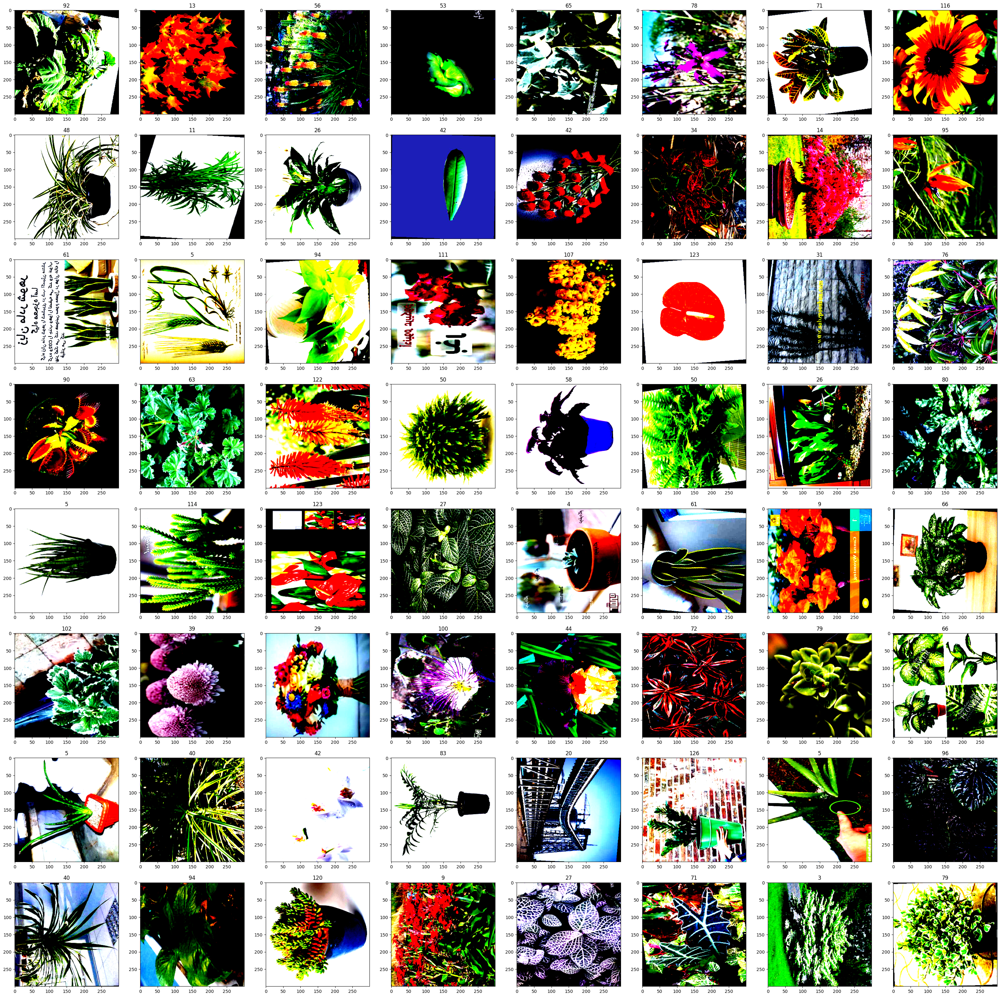

In [ ]:
fig, ax = plt.subplots(nrows = 8, ncols = 8, figsize = (40, 40))
for i in range(8*8):
  ax[i//8][i%8].imshow(X[i].permute(2,1,0).cpu().detach().numpy())
  ax[i//8][i%8].set_title(f'{Y[i]}')

In [ ]:
X, Y, TF = next(iter(data_loader_test))
X, Y, TF = X.to(device), Y.to(device), TF.to(device)
print('X shape:', X.shape, X.dtype)
print('Y shape:', Y.shape, Y.dtype)
print()
Y

X shape: torch.Size([64, 3, 300, 300]) torch.float32
Y shape: torch.Size([64]) torch.int64



tensor([ 22, 101,  97, 113,  82, 105,  94,  94,  18,  16,   0,  92, 102,  69,
          5,  71, 122,  21,  34,  91,  12, 125,  25, 109,  58,  43,  90,  20,
         34,  64,  98, 119,   5,  29, 124,  39,  69, 121,  57,  23,  90,   5,
         34,   9,  81,  85,  46,  62,  58,  51,  12,   5,  89,  35, 128,  40,
         92,  26,  32,  94,  37,  20, 112,   5], device='cuda:0')

In [ ]:
TF

tensor([False,  True,  True, False,  True,  True,  True,  True, False,  True,
         True,  True,  True, False, False,  True, False,  True, False, False,
         True, False,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True, False,  True,  True,  True,  True,  True,  True, False,
         True,  True,  True,  True,  True,  True,  True,  True,  True, False,
         True, False,  True, False,  True, False,  True,  True,  True,  True,
         True,  True, False,  True], device='cuda:0')

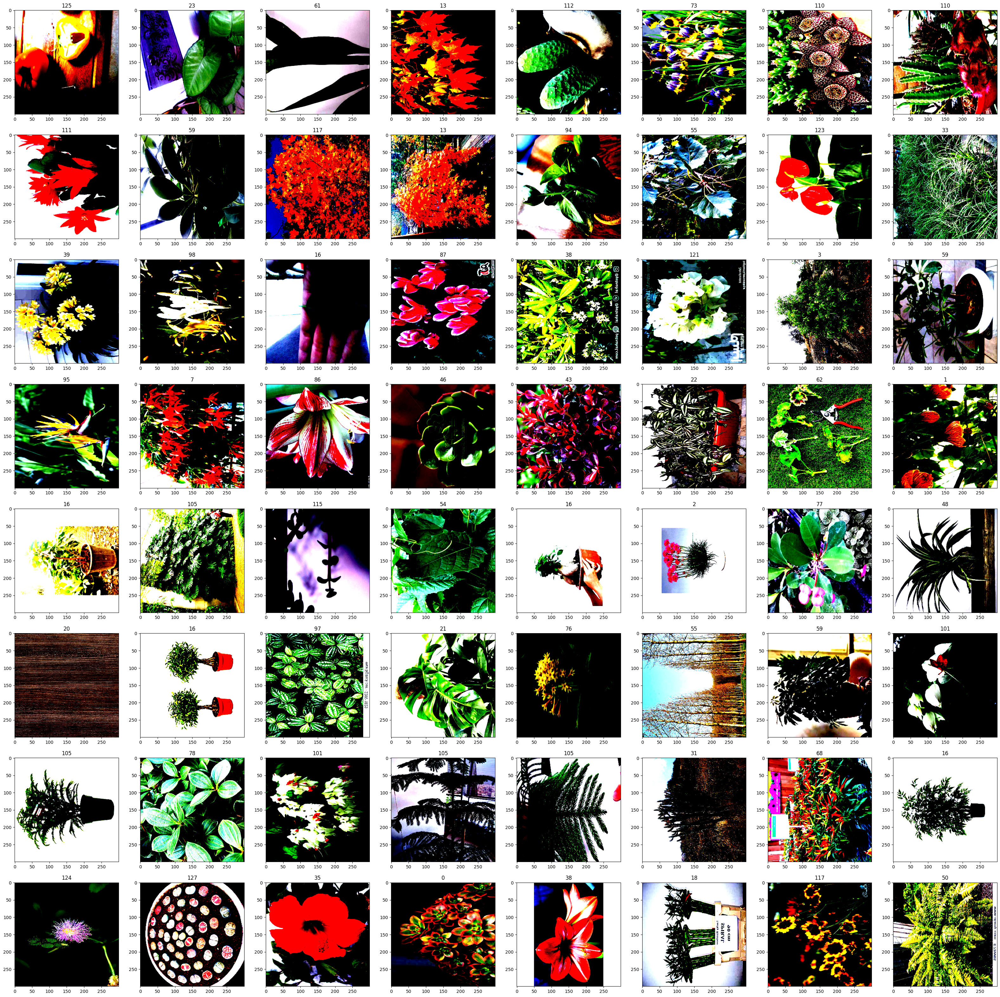

In [ ]:
fig, ax = plt.subplots(nrows = 8, ncols = 8, figsize = (40, 40))
for i in range(8*8):
  ax[i//8][i%8].imshow(X[i].permute(2,1,0).cpu().detach().numpy())
  ax[i//8][i%8].set_title(f'{Y[i]}')

In [23]:
dataloaders ={'train':data_loader_train,'test':data_loader_test}

# Model

In [24]:
class convnet(nn.Module):
    def __init__(self,num_class):
        super(convnet,self).__init__()
        self.base = models.resnet152(pretrained=True)
        self.base.fc = nn.Linear(in_features=2048, out_features=1000, bias=True)

        self.block = nn.Sequential(
            
         nn.Dropout(0.5),
         nn.Linear(in_features=1000, out_features=512, bias=True),
         nn.Dropout(0.5),
         nn.SELU(),
         nn.Linear(in_features=512, out_features=64, bias=True),
         nn.Dropout(0.4),
         nn.SELU(),
         nn.Linear(in_features=64, out_features=num_class, bias=True),
        )
    
    def forward(self,x):
        x = self.base(x)
        x = self.block(x)
        return x

In [25]:
model = convnet(NUM_CLASSES).to(device)
optimizer = torch.optim.Adam(model.parameters(),lr = 0.000005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=4, gamma = 0.2, verbose = True)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:03<00:00, 62.5MB/s]


Adjusting learning rate of group 0 to 5.0000e-06.


## Apex Installation to optimize training

In [ ]:
!git clone https://github.com/NVIDIA/apex
%cd /content/apex
!pip install -v --disable-pip-version-check --no-cache-dir ./
%cd ..

Cloning into 'apex'...
remote: Enumerating objects: 10936, done.
remote: Counting objects: 100% (62/62), done.
remote: Compressing objects: 100% (58/58), done.
remote: Total 10936 (delta 20), reused 25 (delta 4), pack-reused 10874
Receiving objects: 100% (10936/10936), 15.28 MiB | 16.51 MiB/s, done.
Resolving deltas: 100% (7563/7563), done.
/content/apex
Using pip 22.0.4 from /usr/local/lib/python3.9/dist-packages/pip (python 3.9)
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/apex
  Running command python setup.py egg_info


  torch.__version__  = 1.13.1+cu116


  running egg_info
  creating /tmp/pip-pip-egg-info-unkgyo05/apex.egg-info
  writing /tmp/pip-pip-egg-info-unkgyo05/apex.egg-info/PKG-INFO
  writing dependency_links to /tmp/pip-pip-egg-info-unkgyo05/apex.egg-info/dependency_links.txt
  writing requirements to /tmp/pip-pip-egg-info-unkgyo05/apex.egg-info/requires.txt
  writing top-level names to /tmp/pip-p

In [ ]:
from apex import amp
opt_level = 'O2'
model, optimizer = amp.initialize(model, optimizer, opt_level=opt_level)

Selected optimization level O2:  FP16 training with FP32 batchnorm and FP32 master weights.

Defaults for this optimization level are:
enabled                : True
opt_level              : O2
cast_model_type        : torch.float16
patch_torch_functions  : False
keep_batchnorm_fp32    : True
master_weights         : True
loss_scale             : dynamic
Processing user overrides (additional kwargs that are not None)...
After processing overrides, optimization options are:
enabled                : True
opt_level              : O2
cast_model_type        : torch.float16
patch_torch_functions  : False
keep_batchnorm_fp32    : True
master_weights         : True
loss_scale             : dynamic


/usr/local/lib/python3.9/dist-packages/apex/__init__.py:68: DeprecatedFeatureWarning: apex.amp is deprecated and will be removed by the end of February 2023. Use [PyTorch AMP](https://pytorch.org/docs/stable/amp.html)
  warnings.warn(msg, DeprecatedFeatureWarning)


In [26]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CustomLoss(nn.Module):
    def __init__(self, neg_weight=0.5):
        super(CustomLoss, self).__init__()
        self.neg_weight = neg_weight

    def forward(self, outputs, targets, true_false):
        """
        outputs: tensor of shape (batch_size, num_classes)
        targets: tensor of shape (batch_size,)
        true_false: tensor of shape (batch_size,) containing boolean values
        """
        # create a mask for the rows where true_false is True
        mask = true_false.bool()

        # calculate the cross-entropy loss for the true samples
        true_outputs = outputs[mask]
        true_targets = targets[mask]
        true_loss = F.cross_entropy(true_outputs, true_targets)

        # calculate the negative loss for the false samples
        false_outputs = outputs[~mask]
        false_targets = targets[~mask]
        false_loss = self.neg_weight * F.cross_entropy(false_outputs, false_targets)

        # combine the true and false losses
        loss = true_loss + false_loss

        return loss


In [27]:
criterion = CustomLoss()

In [28]:
import time
from tqdm.notebook import tqdm
import copy
def train_model(model, dataloaders, criterion, optimizer, num_epochs):
    since = time.time()

    test_acc_history = []
    train_acc_history = []

    test_loss_history = []
    train_loss_history=[]
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)
        # Each epoch has a training and validation phase
        for phase in ['train', 'test']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            # for inputs, labels in tqdm(dataloaders[phase]):
            t = tqdm(dataloaders[phase])
            for batch_idx, (inputs, labels, true_false) in enumerate(t):

                # t.set_description(f"Acc : {epoch_acc:.2f}, loss : {loss:.2f}")
                # t.refresh()

                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss
                    # Special case for inception because in training it has an auxiliary output. In train
                    #   mode we calculate the loss by summing the final output and the auxiliary output
                    #   but in testing we only consider the final output.
                    
                    
                    outputs = model(inputs)
                    loss = criterion(outputs, labels, true_false)

                    _, preds = torch.max(outputs, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                    

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_acc = running_corrects.double() / len(dataloaders[phase].dataset)

            print('{} Loss: {:.4f}, Acc: {:.4f}, LearningRate: {:0.4}'.format(phase, epoch_loss, epoch_acc, optimizer.param_groups[0]["lr"]))

            # deep copy the model
            if phase == 'test' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
            if phase == 'test':
                test_loss_history.append(epoch_loss)
                test_acc_history.append(epoch_acc)
            if phase == 'train':
                train_loss_history.append(epoch_loss)  
                train_acc_history.append(epoch_acc)

        if ((epoch >= 16) and ( epoch % 4 == 0) ):
              scheduler.step()
        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best test Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, test_acc_history, test_loss_history, train_acc_history, train_loss_history

In [29]:
model.load_state_dict(torch.load('/content/drive/MyDrive/Flower_Classification_ResNet152_97_on_val.pt'))

<All keys matched successfully>

In [30]:
model, test_acc_history,test_loss_history ,train_acc_history , train_loss_history = train_model(model, dataloaders, criterion, optimizer, num_epochs=2)

Epoch 0/1
----------


  0%|          | 0/1055 [00:00<?, ?it/s]

train Loss: 1.9385, Acc: 0.6915, LearningRate: 5e-06


  0%|          | 0/452 [00:00<?, ?it/s]

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the 

test Loss: 2.0482, Acc: 0.6855, LearningRate: 5e-06

Epoch 1/1
----------


  0%|          | 0/1055 [00:00<?, ?it/s]

train Loss: 1.8720, Acc: 0.6987, LearningRate: 5e-06


  0%|          | 0/452 [00:00<?, ?it/s]

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the 

test Loss: 2.1099, Acc: 0.6764, LearningRate: 5e-06

Training complete in 57m 49s
Best test Acc: 0.685545


In [ ]:
torch.save(model.state_dict(), '/content/drive/MyDrive/Flower_Classification_ResNet152_97_on_val.pt')